In [495]:
import pandas as pd
import numpy as np
import os
from datetime import datetime
import datetime as dt
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import correlate
import plotly.graph_objects as go
import statsmodels.api as sm
from scipy.stats import iqr

In [ ]:
"""
Visualize demand on a map
"""

# housing.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4,
# s=housing["population"]/100, label="population", figsize=(10,7),
# c="median_house_value", cmap=plt.get_cmap("jet"), colorbar=True,
# )
# plt.legend()

#TODO: AIDITI



In [496]:
"""
#UNMET demand

Identify clusters of regions that show similar behaviour.
Use a Similarity/distance metric to find Similarity/distance between the entire time series of all pairs of regions 
Ranking of entire time series similairy for each region with all the other regions. 
After finding all pariwise distances, cluster them so that a region's nearest neighbours can be identified on a 2D or 3D plot
Try out different Similarity/distance metrics and repeat steps
Try to form interpretations of theses clusterings. e.g. residential/office/etc.. High/low demand. peak/non-peak season
"""

os.chdir('C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\Rental_Fleet_Demand_Forecast\data\\region_level\outflow_data')
region_unmet_outflow_df = pd.read_csv('region_unmet_outflow.csv')
region_unmet_outflow_df = region_unmet_outflow_df.rename(columns={"Unnamed: 0": "datetime"})
region_unmet_outflow_df


#TODO: Aditi



,datetime,Ang Mo Kio,Bedok,Bidadari,Bishan,Bukit Batok,Bukit Merah,Bukit Panjang,Bukit Timah,Central,...,Sembawang,Sengkang,Sentosa,Serangoon,Tampines,Toa Payoh,Whampoa,Woodlands,Woodland,Yishun
0,2021-09-24 00:00:00,0,0,0,0,0,0,0,0,4,...,0,0,0,0,0,0,0,0,0,0
1,2021-09-24 01:00:00,0,0,0,0,0,2,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2021-09-24 02:00:00,0,0,0,0,0,0,0,4,2,...,0,0,2,0,0,0,0,0,0,0
3,2021-09-24 03:00:00,0,0,0,0,0,0,0,0,0,...,0,0,2,0,0,0,0,0,0,0
4,2021-09-24 04:00:00,0,0,0,0,0,0,0,0,0,...,0,0,4,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2175,2021-12-23 15:00:00,0,2,0,1,0,1,4,0,2,...,0,1,0,0,0,0,0,2,0,2
2176,2021-12-23 16:00:00,1,1,0,0,3,2,6,0,2,...,0,0,0,1,5,0,0,2,0,0
2177,2021-12-23 17:00:00,0,0,0,1,1,1,0,0,0,...,0,1,0,1,0,1,0,0,0,0
2178,2021-12-23 18:00:00,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [497]:
"""
#MET demand

Identify clusters of regions that show similar behaviour.
Use a Similarity/distance metric to find Similarity/distance between the entire time series of all pairs of regions 
Ranking of entire time series similairy for each region with all the other regions. 
After finding all pariwise distances, cluster them so that a region's nearest neighbours can be identified on a 2D or 3D plot
Try out different Similarity/distance metrics and repeat steps
Try to form interpretations of theses clusterings. e.g. residential/office/etc.. High/low demand. peak/non-peak season

"""
os.chdir('C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\Rental_Fleet_Demand_Forecast\data\\region_level\outflow_data')
region_met_outflow_df = pd.read_csv('region_met_outflow.csv')
region_met_outflow_df = region_met_outflow_df.rename(columns={"Unnamed: 0": 'datetime'})
region_met_outflow_df

#TODO: Aditi


,datetime,Ang Mo Kio,Bedok,Bidadari,Bishan,Bukit Batok,Bukit Merah,Bukit Panjang,Bukit Timah,Central,...,Sembawang,Sengkang,Sentosa,Serangoon,Tampines,Toa Payoh,Whampoa,Woodlands,Woodland,Yishun
0,2021-09-24 00:00:00,5.0,5.0,1.0,1.0,1.0,3.0,3.0,0.0,11.0,...,0.0,6.0,0.0,2.0,3.0,4.0,2.0,3.0,3.0,3.0
1,2021-09-24 01:00:00,5.0,1.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,...,0.0,3.0,0.0,2.0,4.0,1.0,0.0,1.0,0.0,3.0
2,2021-09-24 02:00:00,2.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,2.0,...,2.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0
3,2021-09-24 03:00:00,0.0,2.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,...,2.0,2.0,0.0,0.0,3.0,0.0,1.0,0.0,0.0,0.0
4,2021-09-24 04:00:00,2.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2175,2021-12-23 15:00:00,7.0,8.0,1.0,3.0,2.0,16.0,5.0,3.0,40.0,...,0.0,10.0,1.0,4.0,20.0,6.0,3.0,13.0,2.0,5.0
2176,2021-12-23 16:00:00,7.0,8.0,0.0,6.0,7.0,23.0,4.0,2.0,38.0,...,2.0,7.0,4.0,8.0,18.0,7.0,0.0,14.0,2.0,11.0
2177,2021-12-23 17:00:00,13.0,15.0,0.0,5.0,10.0,22.0,2.0,2.0,34.0,...,5.0,14.0,5.0,1.0,18.0,4.0,5.0,8.0,3.0,18.0
2178,2021-12-23 18:00:00,16.0,9.0,0.0,5.0,3.0,20.0,7.0,4.0,30.0,...,8.0,11.0,2.0,2.0,12.0,8.0,0.0,13.0,0.0,14.0


In [498]:
"""
#TOTAL demand

Identify clusters of regions that show similar behaviour.
Use a Similarity/distance metric to find Similarity/distance between the entire time series of all pairs of regions 
Ranking of entire time series similairy for each region with all the other regions. 
After finding all pariwise distances, cluster them so that a region's nearest neighbours can be identified on a 2D or 3D plot
Try out different Similarity/distance metrics and repeat steps
Try to form interpretations of theses clusterings. e.g. residential/office/etc.. High/low demand. peak/non-peak season

"""
os.chdir('C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\Rental_Fleet_Demand_Forecast\data\\region_level\outflow_data')
region_total_outflow_df = pd.read_csv('region_total_outflow.csv')
region_total_outflow_df = region_total_outflow_df.rename(columns={"Unnamed: 0": 'datetime'})
region_total_outflow_df

#TODO: Aditi


,datetime,Ang Mo Kio,Bedok,Bidadari,Bishan,Bukit Batok,Bukit Merah,Bukit Panjang,Bukit Timah,Central,...,Sembawang,Sengkang,Sentosa,Serangoon,Tampines,Toa Payoh,Whampoa,Woodlands,Woodland,Yishun
0,2021-09-24 00:00:00,5.0,5.0,1.0,1.0,1.0,3.0,3.0,0.0,15.0,...,0.0,6.0,0.0,2.0,3.0,4.0,2.0,3.0,3.0,3.0
1,2021-09-24 01:00:00,5.0,1.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,...,0.0,3.0,0.0,2.0,4.0,1.0,0.0,1.0,0.0,3.0
2,2021-09-24 02:00:00,2.0,0.0,0.0,0.0,1.0,1.0,0.0,5.0,4.0,...,2.0,1.0,2.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0
3,2021-09-24 03:00:00,0.0,2.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,...,2.0,2.0,2.0,0.0,3.0,0.0,1.0,0.0,0.0,0.0
4,2021-09-24 04:00:00,2.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,...,0.0,0.0,4.0,0.0,1.0,0.0,0.0,4.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2175,2021-12-23 15:00:00,7.0,10.0,1.0,4.0,2.0,17.0,9.0,3.0,42.0,...,0.0,11.0,1.0,4.0,20.0,6.0,3.0,15.0,2.0,7.0
2176,2021-12-23 16:00:00,8.0,9.0,0.0,6.0,10.0,25.0,10.0,2.0,40.0,...,2.0,7.0,4.0,9.0,23.0,7.0,0.0,16.0,2.0,11.0
2177,2021-12-23 17:00:00,13.0,15.0,0.0,6.0,11.0,23.0,2.0,2.0,34.0,...,5.0,15.0,5.0,2.0,18.0,5.0,5.0,8.0,3.0,18.0
2178,2021-12-23 18:00:00,16.0,9.0,0.0,5.0,3.0,20.0,7.0,4.0,30.0,...,8.0,11.0,2.0,2.0,12.0,8.0,0.0,13.0,0.0,14.0


In [499]:
"""
Where is demand from a region going to become supply in other regions?

Cross-Correlation between each region's met demand and all regions' inflow.
Cross-Correlation handles current and future inflows
### NO NEED Cross-correlation. only check present, 1 hour and 2 hour leading pearson correlaiton coefficient

Sometimes demand can become supply within the region, not necessarily leave the region.

check linearity of scatter plot before applying pearson correlation.

"""
import scipy.stats as stats

os.chdir('C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\Rental_Fleet_Demand_Forecast\data\\region_level\inflow_data')
region_inflow_df = pd.read_csv('region_inflow.csv')
region_inflow_df = region_inflow_df.rename(columns={"Unnamed: 0": 'datetime'})

for col_outf in region_met_outflow_df.columns[1:]:
    print('\n')
    print('Region: ',col_outf)
    rank_dict = {}
    for col_inf in region_inflow_df.columns[1:]:
        #if col_outf != col_inf: # check correlation between other regions
        ## positive correlation means that the cars entered
        ## negative correlation means cars did not enter
        ## cross correlation with largest sum of all positive cross correlations indicates region into which cars entered 
        ## cross correlation with smallest sum of all negative cross correlations indicates region into which cars did NOT entered, this helps to eliminate non-entered regions
        time_series1 = region_met_outflow_df[col_outf]
        time_series2 = region_inflow_df[col_inf]

        time_series2_lead1 = time_series2.shift(periods=-1).dropna()
        time_series2_lead2 = time_series2.shift(periods=-2).dropna()
        
        rank_dict[col_inf] = []

        # original inflow time series
        r, p = stats.pearsonr(time_series1, time_series2)
        rank_dict[col_inf] = r
        # plt.scatter(x=time_series1,y=time_series2)
        # plt.xlabel('demand: '+str(col_outf))
        # plt.ylabel('supply: '+str(col_inf))
        # plt.title('rho: '+str(r))
        # plt.show()

        # lead 1 hour inflow time series
        r1, p1 = stats.pearsonr(time_series1[:-1], time_series2_lead1)
        rank_dict[col_inf+'_lead1'] = r1
        # plt.scatter(x=time_series1[:-1],y=time_series2_lead1)
        # plt.xlabel('demand: '+str(col_outf))
        # plt.ylabel('supply lead 1 hour: '+str(col_inf))
        # plt.title('rho: '+str(r1))
        # plt.show()

        # lead 2 hours inflow time series
        r2, p2 = stats.pearsonr(time_series1[:-2], time_series2_lead2)
        rank_dict[col_inf+'_lead2'] = r2
        # plt.scatter(x=time_series1[:-2],y=time_series2_lead2)
        # plt.xlabel('demand: '+str(col_outf))
        # plt.ylabel('supply lead 2 hours: '+str(col_inf))
        # plt.title('rho: '+str(r2))
        # plt.show()

    # Sort the dictionary based on values in descending order
    sorted_dict = sorted(rank_dict.items(), key=lambda x: x[1], reverse=True)
    # Get the three largest key-value pairs
    top_sorted = sorted_dict[:3]
    # Print the result
    print(col_outf,'outflow has LARGEST correlations with following inflows:')
    for key, value in top_sorted:
        print(key, value)
    bottom_sorted = sorted_dict[-3:]
    # Print the result
    print(col_outf,'outflow has SMALLEST correlations with following inflows:')
    for key, value in bottom_sorted:
        print(key, value)
    






Region:  Ang Mo Kio
Ang Mo Kio outflow has LARGEST correlations with following inflows:
Tampines 0.714735407480982
Sengkang_lead1 0.7122014984289433
Tampines_lead1 0.703842164417149
Ang Mo Kio outflow has SMALLEST correlations with following inflows:
Sentosa_lead2 0.044724078290284186
Novena_lead1 0.028489161795619306
Novena_lead2 -0.09100885797186412


Region:  Bedok
Bedok outflow has LARGEST correlations with following inflows:
Tampines 0.7316916941121849
Tampines_lead1 0.7244262260850743
Sengkang_lead1 0.7234701621790309
Bedok outflow has SMALLEST correlations with following inflows:
Novena_lead1 0.0514060166029235
Sentosa_lead2 0.015046014118636132
Novena_lead2 -0.08685464287982615


Region:  Bidadari
Bidadari outflow has LARGEST correlations with following inflows:
Tampines 0.420935933324613
Sengkang 0.41618228224022763
Ang Mo Kio 0.4036049325370206
Bidadari outflow has SMALLEST correlations with following inflows:
Novena 0.006860822328182869
Sentosa_lead2 -0.04140440791906409
N

In [500]:
"""
Compare with information from actual transaction logs

Form connectivity matrix for each hour from trascation logs. 

connectivity matrix = number of cars leaving a source and entering destination

    destination stn
       A B C D E
s    A
o    B
u    C
r    D
c    E
e
stn

Create frobenius/euclidean norm of each matrix to quantify large activity 
Rank the matrices to identify hours of maxium activity 
Compare the results with correlation analysis from above.

"""

#TODO : ADITI

'\nCompare with information from actual transaction logs\n\nForm connectivity matrix for each hour from trascation logs. \n\nconnectivity matrix = number of cars leaving a source and entering destination\n\n    destination stn\n       A B C D E\ns    A\no    B\nu    C\nr    D\nc    E\ne\nstn\n\nCreate frobenius/euclidean norm of each matrix to quantify large activity \nRank the matrices to identify hours of maxium activity \nCompare the results with correlation analysis from above.\n\n'

In [501]:
"""
UNMET demand
1) 
2) check FFT of top 3 periods, check lags of top 3 PACF plots
3) boxplot to see distribution of demand during each region's hour of the weekday. 
4) optional Treemap to verify boxplot above.

This info. can be used for performance monitoring. sum of cluster 
outputs from the same region is within this box plot. 

"""
os.chdir('C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\Rental_Fleet_Demand_Forecast\data\\region_level\outflow_data')
region_unmet_outflow_df = pd.read_csv('region_unmet_outflow.csv')
region_unmet_outflow_df = region_unmet_outflow_df.rename(columns={"Unnamed: 0": 'datetime'})

## FFT and IFFT to identify the significant periods in UNMET demand
print('\t\t\tFFT analysis of regions\n')
for reg in region_unmet_outflow_df.columns[1:]:
    print(reg)

    # Perform the FFT on the data
    fft_result = np.fft.fft(region_unmet_outflow_df[reg].values)
    # Compute the magnitudes of the FFT result
    fft_magnitudes = np.abs(fft_result)
    # Generate the corresponding frequency axis
    sampling_rate = 1.0  # Assuming a sampling rate of 1.0 (change as needed)
    frequency_axis = np.fft.fftfreq(len(fft_result), 1 / sampling_rate)
    positive_freq_indices = np.where(frequency_axis >= 0)
    # Plot the FFT result versus frequency
    # fig = go.Figure(data=go.Scatter(x=frequency_axis[positive_freq_indices], y=fft_magnitudes[positive_freq_indices],mode='lines+markers'))
    # fig.update_layout(
    #     title='FFT Result versus Frequency (unmet demand)',
    #     xaxis_title="Frequency",
    #     yaxis_title="Magnitude",
    #     autosize=False,
    #     width=1000,
    #     height=800,
    # )
    # fig.show()

    """ TOP periods/frequencies in the time series"""
    # Sort the magnitudes and frequencies in descending order
    sorted_indices = np.argsort(fft_magnitudes[positive_freq_indices])[::-1]
    sorted_magnitudes = fft_magnitudes[positive_freq_indices][sorted_indices]
    sorted_frequencies = frequency_axis[positive_freq_indices][sorted_indices]
    # Select the top 8 periods
    top_freq = sorted_frequencies[1:6] # REMOVE dc/mean component
    top_periods = 1/top_freq
    top_periods = [round(p) for p in top_periods]
    print(f'Top FFT periods in unmet demand are : {top_periods}')
    if ((12 and 168) not in top_periods):
        print('\t\tNO daily AND Weekly Seasonality TOGETHER!!')
    if ((12 and 168) not in top_periods[:2]):
        print('\t\tDaily AND Weekly Seasonality are NOT top 2 Frequencies!! Presence of BUSINESS/ECONOMIC cycle!')





			FFT analysis of regions

Ang Mo Kio
Top FFT periods in unmet demand are : [24, 168, 28, 84, 21]
Bedok
Top FFT periods in unmet demand are : [24, 168, 12, 28, 21]
Bidadari
Top FFT periods in unmet demand are : [24, 168, 14, 6, 9]
Bishan
Top FFT periods in unmet demand are : [24, 168, 84, 5, 24]
Bukit Batok
Top FFT periods in unmet demand are : [24, 168, 21, 28, 84]
Bukit Merah
Top FFT periods in unmet demand are : [24, 12, 168, 84, 12]
		Daily AND Weekly Seasonality are NOT top 2 Frequencies!! Presence of BUSINESS/ECONOMIC cycle!
Bukit Panjang
Top FFT periods in unmet demand are : [24, 168, 84, 28, 21]
Bukit Timah
Top FFT periods in unmet demand are : [24, 8, 12, 168, 21]
		Daily AND Weekly Seasonality are NOT top 2 Frequencies!! Presence of BUSINESS/ECONOMIC cycle!
Central
Top FFT periods in unmet demand are : [24, 12, 12, 8, 168]
		Daily AND Weekly Seasonality are NOT top 2 Frequencies!! Presence of BUSINESS/ECONOMIC cycle!
Changi
Top FFT periods in unmet demand are : [24, 12, 168,

In [502]:

""" PACF plot of region unmet demand"""

## FFT and IFFT to identify the significant periods in UNMET demand
print('\t\t\PACF analysis of regions\n')
for reg in region_unmet_outflow_df.columns[1:]:
    time_series = region_unmet_outflow_df[reg].values

    # Compute the ACF and PACF using the statsmodels library
    pacf_values = sm.tsa.stattools.pacf(time_series, nlags=len(time_series)//7, method='ywm')

    # Plot the PACF
    fig = go.Figure(data=go.Scatter(x=np.arange(len(pacf_values)), y=pacf_values,mode='lines+markers'))
    fig.add_hline(y=-1.96/np.sqrt(len(time_series)),line_width=3, line_dash="dash", line_color="green")
    fig.add_hline(y=1.96/np.sqrt(len(time_series)),line_width=3, line_dash="dash", line_color="green")
    fig.update_layout(
        title='Partial Autocorrelation Function (PACF) (unmet demand), Region: '+ reg,
        xaxis_title="Time Lag",
        yaxis_title="PACF",
        autosize=False,
        width=1000,
        height=800,
    )
    fig.show()

		\PACF analysis of regions



In [503]:
"""
Pandas Profiling
"""

# print('\t\t\tPandas Profiling of regions\n')
# for reg in region_unmet_outflow_df.columns[1:]:
#     print(reg)
#     profile = ProfileReport(region_unmet_outflow_df, tsmode=True, sortby="datetime")
#     os.chdir('C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\Rental_Fleet_Demand_Forecast\docs\\read_me\pandas_data_profile\\region_level')
#     profile.to_file(reg+'_unmet_outflow_profile_report.html')


'\nPandas Profiling\n'

In [504]:
"""
High-level statistical comparison of unmet demand across regions
"""

print('\t\t High-level statistical comparison of unmet demand across regions\n')

region_total_unmet_outflow = {}
region_max_peak_n_datetime = {}
region_average_unmet_outflow = {}
region_median_unmet_outflow = {}
region_std_unmet_outflow = {}

for reg in region_unmet_outflow_df.columns[1:]:
    region_max_value = region_unmet_outflow_df[reg].max()
    max_time = region_unmet_outflow_df[region_unmet_outflow_df[reg] == region_unmet_outflow_df[reg].max()]['datetime']
    region_max_peak_n_datetime[reg] = []
    region_max_peak_n_datetime[reg].append(region_max_value)
    region_max_peak_n_datetime[reg].append(max_time.values) 

    region_total_unmet_outflow[reg] = region_unmet_outflow_df[reg].sum()
    region_average_unmet_outflow[reg] = region_unmet_outflow_df[reg].mean() 
    region_median_unmet_outflow[reg] = region_unmet_outflow_df[reg].median()
    region_std_unmet_outflow[reg] = region_unmet_outflow_df[reg].std()

#HIGHEST
top_x = 5

## 3 regions with Highest total unmet demand
total_sorted_up =  sorted(region_total_unmet_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with HIGHEST total unmet demand: ',total_sorted_up[:top_x])

## 3 regions with Highest average unmet demand
avg_sorted_up =  sorted(region_average_unmet_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with Highest average unmet demand: ',avg_sorted_up[:top_x])

## 3 regions with Highest median unmet demand
median_sorted_up =  sorted(region_median_unmet_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with Highest median unmet demand: ',median_sorted_up[:top_x])

## 3 regions with Highest std unmet demand
std_sorted_up =  sorted(region_std_unmet_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with Highest std unmet demand: ',std_sorted_up[:top_x])

## 3 regions with Maximum peak unmet demand and datetime
max_peak_n_datetime_sorted_up = sorted(region_max_peak_n_datetime.items(), key=lambda x: x[1][0],reverse=True )
print('Top 3 regions with HIGHEST Maximum peak unmet demand and datetime: ',max_peak_n_datetime_sorted_up[:3])


#LOWEST

## 3 regions with Lowest total unmet demand
total_sorted_down =  sorted(region_total_unmet_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with LOWEST total unmet demand: ',total_sorted_down[-top_x:])

## 3 regions with Lowest average unmet demand
avg_sorted_down =  sorted(region_average_unmet_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with LOWEST average unmet demand: ',avg_sorted_down[-top_x:])

## 3 regions with Lowest median unmet demand
median_sorted_down =  sorted(region_median_unmet_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with LOWEST median unmet demand: ',median_sorted_down[-top_x:])

## 3 regions with Lowest std unmet demand
std_sorted_down =  sorted(region_std_unmet_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with LOWEST std unmet demand: ',std_sorted_down[-top_x:])

## 3 regions with Minimum peak unmet demand and datetime
max_peak_n_datetime_sorted_down = sorted(region_max_peak_n_datetime.items(), key=lambda x: x[1][0],reverse=True )
print('Top 3 regions with LOWEST Maximum peak unmet demand and datetime: ',max_peak_n_datetime_sorted_down[-3:])


		 High-level statistical comparison of unmet demand across regions

Top 3 regions with HIGHEST total unmet demand:  [('Central', 9297), ('Tampines', 4063), ('Jurong West', 2872), ('Sengkang', 2663), ('Bukit Merah', 2610)]
Top 3 regions with Highest average unmet demand:  [('Central', 4.264678899082568), ('Tampines', 1.8637614678899082), ('Jurong West', 1.3174311926605504), ('Sengkang', 1.221559633027523), ('Bukit Merah', 1.1972477064220184)]
Top 3 regions with Highest median unmet demand:  [('Central', 1.0), ('Tampines', 1.0), ('Ang Mo Kio', 0.0), ('Bedok', 0.0), ('Bidadari', 0.0)]
Top 3 regions with Highest std unmet demand:  [('Central', 8.019660338135754), ('Tampines', 2.7838234242238213), ('Jurong West', 2.577334184432841), ('Sengkang', 2.1401113292817273), ('Bukit Merah', 1.9758969226735912)]
Top 3 regions with HIGHEST Maximum peak unmet demand and datetime:  [('Central', [66, array(['2021-12-04 21:00:00'], dtype=object)]), ('Punggol', [30, array(['2021-09-26 10:00:00'], dtype=ob

In [505]:
"""
High-level statistical comparison of TOTAL demand across regions
"""
os.chdir('C:\Work\WORK_PACKAGE\Demand_forecasting\github\DeepAR-pytorch\My_model\Rental_Fleet_Demand_Forecast\data\\region_level\outflow_data')
region_total_outflow_df = pd.read_csv('region_total_outflow.csv')
region_total_outflow_df = region_total_outflow_df.rename(columns={"Unnamed: 0": 'datetime'})

print('\t\t High-level statistical comparison of TOTAL demand across regions\n')

region_total_TOTAL_outflow = {}
region_max_peak_n_datetime = {}
region_average_TOTAL_outflow = {}
region_median_TOTAL_outflow = {}
region_std_TOTAL_outflow = {}

for reg in region_total_outflow_df.columns[1:]:
    region_max_value = region_total_outflow_df[reg].max()
    max_time = region_total_outflow_df[region_total_outflow_df[reg] == region_total_outflow_df[reg].max()]['datetime']
    region_max_peak_n_datetime[reg] = []
    region_max_peak_n_datetime[reg].append(region_max_value)
    region_max_peak_n_datetime[reg].append(max_time.values) 

    region_total_TOTAL_outflow[reg] = region_total_outflow_df[reg].sum()
    region_average_TOTAL_outflow[reg] = region_total_outflow_df[reg].mean() 
    region_median_TOTAL_outflow[reg] = region_total_outflow_df[reg].median()
    region_std_TOTAL_outflow[reg] = region_total_outflow_df[reg].std()

#HIGHEST
top_x = 5 # top x number of regions

## 3 regions with Highest total TOTAL demand
total_sorted_up =  sorted(region_total_TOTAL_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with HIGHEST total TOTAL demand: ',total_sorted_up[:top_x])

## 3 regions with Highest average TOTAL demand
avg_sorted_up =  sorted(region_average_TOTAL_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with Highest average TOTAL demand: ',avg_sorted_up[:top_x])

## 3 regions with Highest median TOTAL demand
median_sorted_up =  sorted(region_median_TOTAL_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with Highest median TOTAL demand: ',median_sorted_up[:top_x])

## 3 regions with Highest std TOTAL demand
std_sorted_up =  sorted(region_std_TOTAL_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with Highest std TOTAL demand: ',std_sorted_up[:top_x])

## 3 regions with Maximum peak TOTAL demand and datetime
max_peak_n_datetime_sorted_up = sorted(region_max_peak_n_datetime.items(), key=lambda x: x[1][0],reverse=True )
print('Top 3 regions with HIGHEST Maximum peak TOTAL demand and datetime: ',max_peak_n_datetime_sorted_up[:3])


#LOWEST

## 3 regions with Lowest total TOTAL demand
total_sorted_down =  sorted(region_total_TOTAL_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with LOWEST total TOTAL demand: ',total_sorted_down[-top_x:])

## 3 regions with Lowest average TOTAL demand
avg_sorted_down =  sorted(region_average_TOTAL_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with LOWEST average TOTAL demand: ',avg_sorted_down[-top_x:])

## 3 regions with Lowest median TOTAL demand
median_sorted_down =  sorted(region_median_TOTAL_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with LOWEST median TOTAL demand: ',median_sorted_down[-top_x:])

## 3 regions with Lowest std TOTAL demand
std_sorted_down =  sorted(region_std_TOTAL_outflow.items(), key=lambda x: x[1],reverse=True )
print('Top 3 regions with LOWEST std TOTAL demand: ',std_sorted_down[-top_x:])

## 3 regions with Minimum peak TOTAL demand and datetime
max_peak_n_datetime_sorted_down = sorted(region_max_peak_n_datetime.items(), key=lambda x: x[1][0],reverse=True )
print('Top 3 regions with LOWEST Maximum peak TOTAL demand and datetime: ',max_peak_n_datetime_sorted_down[-3:])


		 High-level statistical comparison of TOTAL demand across regions

Top 3 regions with HIGHEST total TOTAL demand:  [('Central', 40021.0), ('Tampines', 29116.0), ('Jurong West', 23048.0), ('Woodlands', 21964.0), ('Bukit Merah', 21365.0)]
Top 3 regions with Highest average TOTAL demand:  [('Central', 18.358256880733943), ('Tampines', 13.355963302752293), ('Jurong West', 10.572477064220184), ('Woodlands', 10.075229357798165), ('Bukit Merah', 9.80045871559633)]
Top 3 regions with Highest median TOTAL demand:  [('Central', 12.0), ('Tampines', 12.0), ('Jurong West', 10.0), ('Sengkang', 9.0), ('Woodlands', 9.0)]
Top 3 regions with Highest std TOTAL demand:  [('Central', 17.76369803976064), ('Tampines', 9.079723701985062), ('Bukit Merah', 7.793520553412822), ('Jurong West', 6.903037509540589), ('Woodlands', 6.467543934586812)]
Top 3 regions with HIGHEST Maximum peak TOTAL demand and datetime:  [('Central', [93.0, array(['2021-12-04 21:00:00'], dtype=object)]), ('Bukit Merah', [52.0, array(['

<AxesSubplot:title={'center':'Weekday-hour mean Groupby TOTAL outflow/demand'}, xlabel='None-None', ylabel='weekday-hour'>

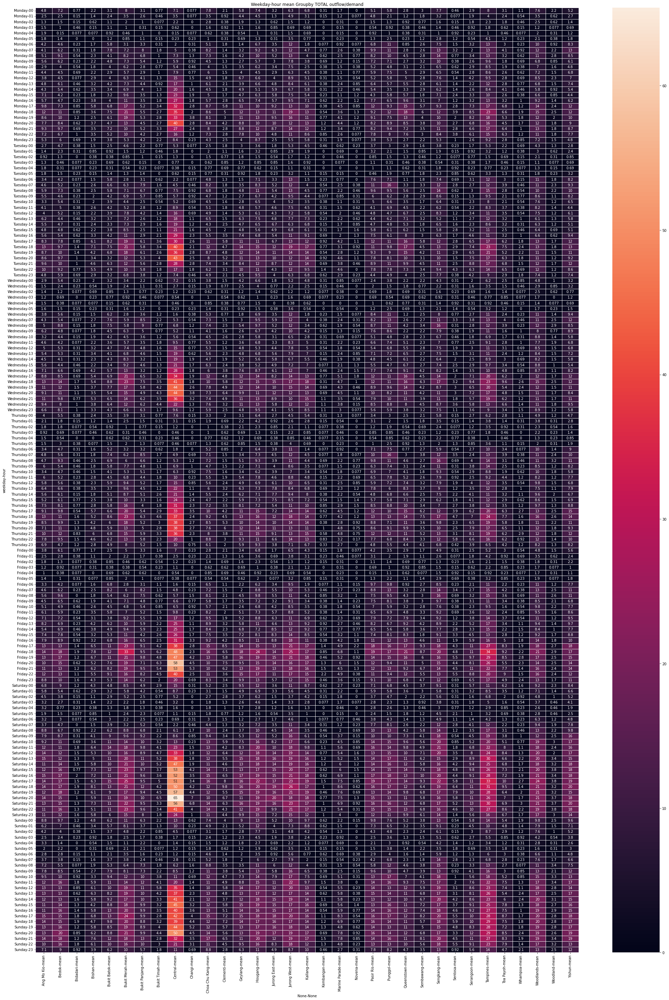

In [506]:
"""
extraction of seasonal patterns, peak patterns and other persistent 
patterns for performance monitoring of predictions 

pass these patterns to performance_monitor.ipynb

	5) We can cluster regions with high unmet demand during certain times of the day.
		a. First establish that each of the 32 time series have weekly seasonality and are very similar week over week.
		b. Try to aggregate all times into hours in a single week. As all weeks are similar. Create box plots to find out these bounds that can be used by the new loss function.
Cluster regions with high demand at different times/hours of the week.

"""

region_total_outflow_df['datetime'] = region_total_outflow_df['datetime'].apply( lambda x: datetime.strptime(x,"%Y-%m-%d %H:%M:%S") )

region_total_outflow_df.insert(1, 'weekday',region_total_outflow_df['datetime'].dt.strftime('%A') )
region_total_outflow_df.insert(1, 'hour',region_total_outflow_df['datetime'].dt.strftime('%H') )

#You first create your list in the order you want it
days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
#Using Categorical() function to set the order according to how it is arranged above
region_total_outflow_df["weekday"] = pd.Categorical(region_total_outflow_df.weekday, categories=days, ordered=True)
#region_total_outflow_df.drop(columns=['datetime'],inplace=True)
week_df = region_total_outflow_df.groupby ( by=["weekday","hour"] ).agg([np.mean])

week_df.drop(columns=['datetime'],inplace=True)
fig, ax = plt.subplots(figsize=(35,50))         # Sample figsize in inches
ax.set_title('Weekday-hour mean Groupby TOTAL outflow/demand')
sns.heatmap(week_df, annot=True,linewidths=.5, ax=ax)


# #Pivot table implementation
# pivot = pd.pivot_table(region_total_outflow_df, values=region_total_outflow_df.columns[1:], index=['hour'], columns=['weekday'], aggfunc=np.mean)
# pivot.loc['00',('Ang Mo Kio','Friday')]

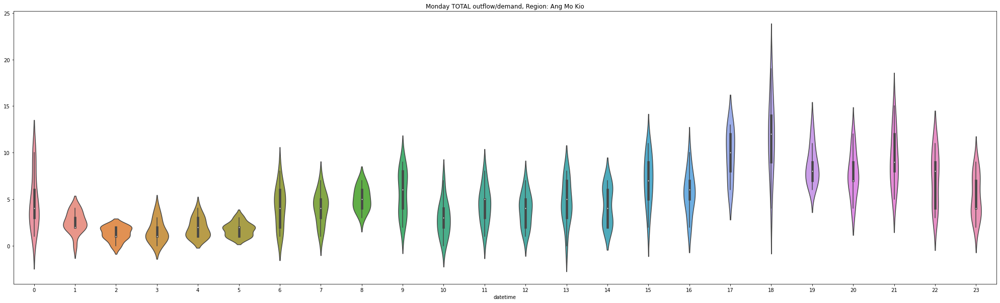

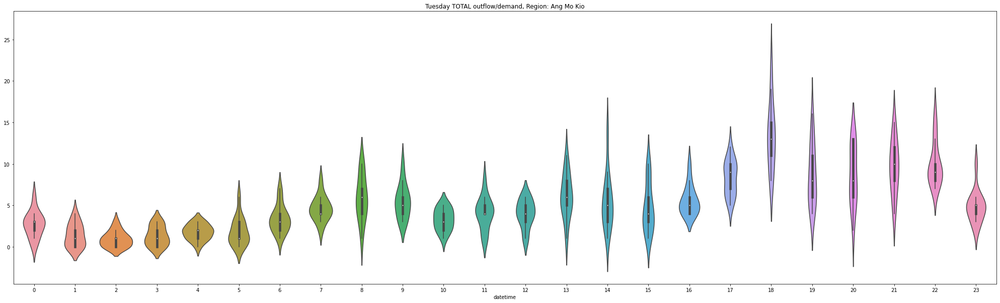

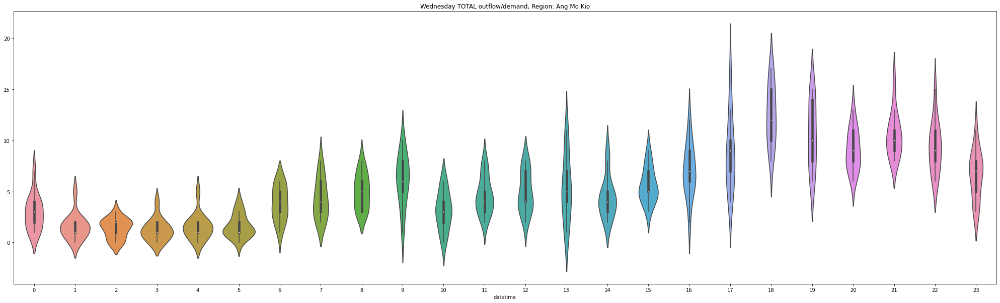

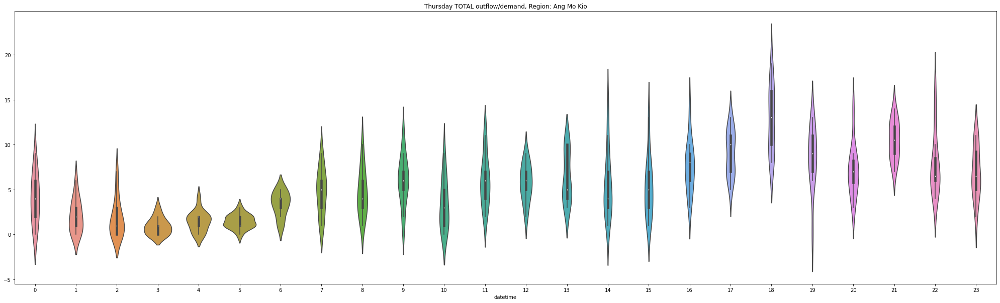

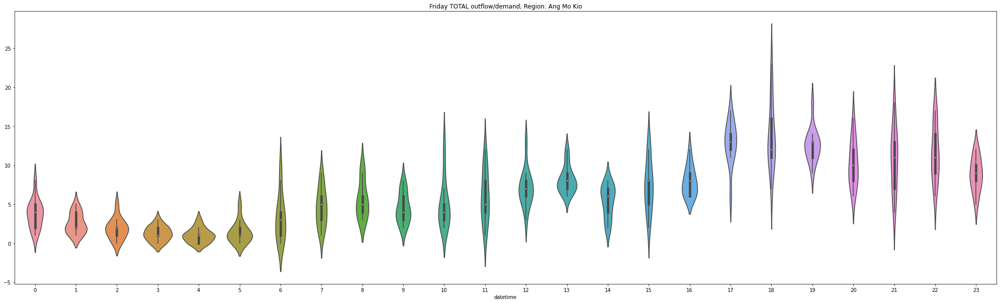

...

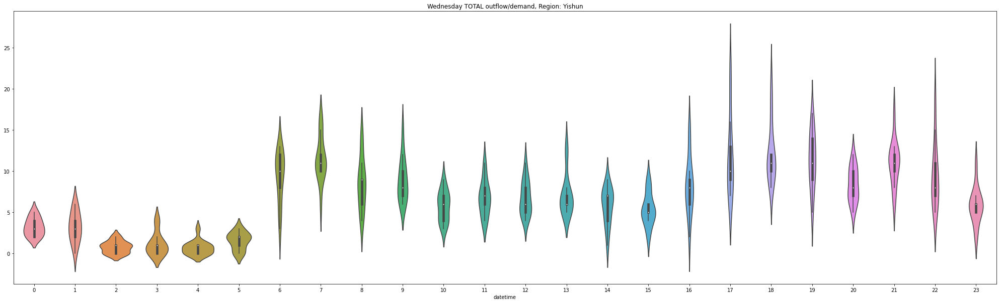

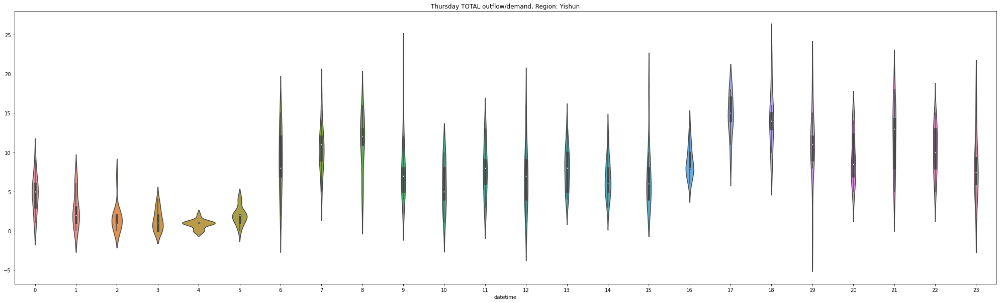

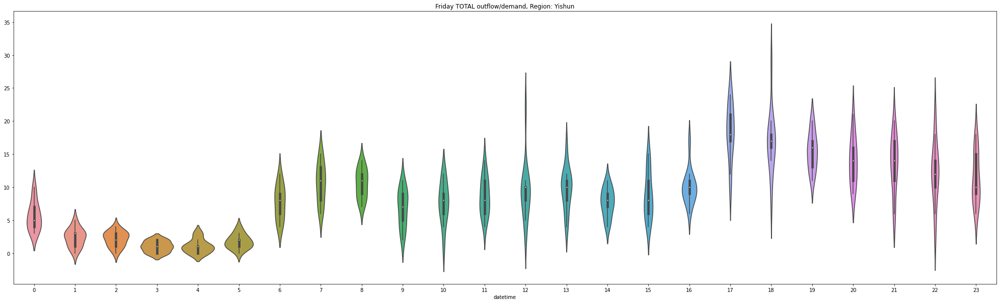

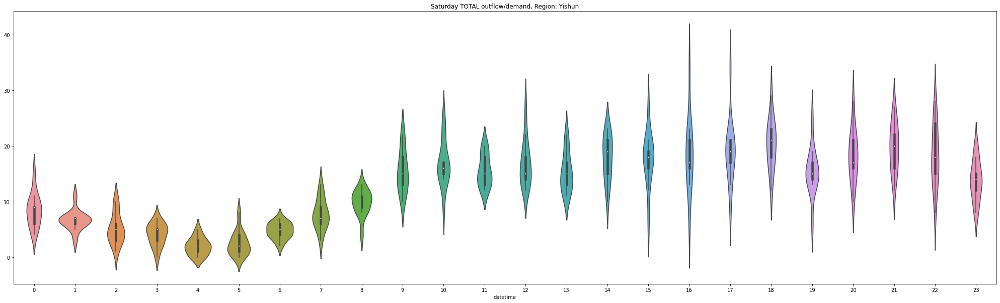

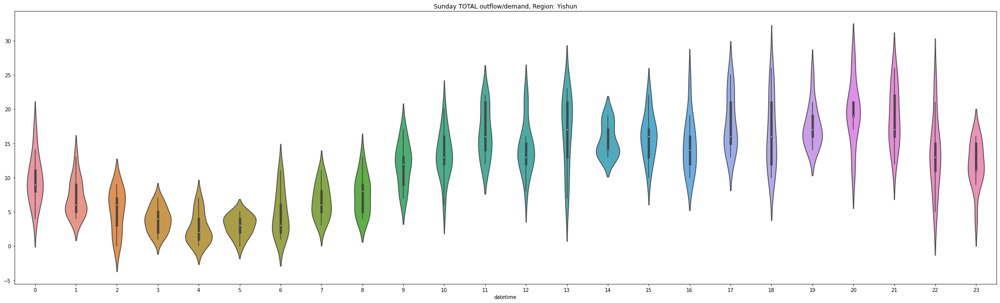

In [508]:
"""
Boxplot 

"""

for reg in region_total_outflow_df.columns[3:]:

    # pick only sundays
    weekday = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday","Sunday"]
    for day in weekday:
        day_df = region_total_outflow_df[ region_total_outflow_df['weekday'] == day]
        ts = day_df[reg].values

        # Top and Bottom Whisker to define upper bound and Lower bound on prediciotn data.
        hour_df_75_perc = day_df.groupby(by=['hour'])[reg].quantile(.75)# agg(np.percentile(75))
        hour_df_25_perc = day_df.groupby(by=['hour'])[reg].quantile(.25) #.agg(np.percentile(25))
        hour_df_iqr = day_df.groupby(by=['hour'])[reg].agg(iqr)
        hour_top_whisker = hour_df_75_perc + 1.5*hour_df_iqr
        hour_bottom_whisker = hour_df_25_perc - 1.5*hour_df_iqr

        # print(hour_top_whisker)
        # print(hour_bottom_whisker)

        fig, ax = plt.subplots(figsize=(35,10))
        ax.set_title(str(day) +' TOTAL outflow/demand, Region: '+str(reg))
        sns.violinplot(x = day_df['datetime'].dt.hour, y = ts, ax = ax)



In [509]:
"""


"""

'\n\n\n'

In [510]:
"""
Feature engineering

shortlist relevant features from analysis of each region to input to deepar model 

"""


region_total_outflow_df['datetime'][0]


Timestamp('2021-09-24 00:00:00')